In [7]:
import cv2
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.optim import Adam
from torchvision.io import read_image
import torchvision.transforms as T
import kornia as K
from kornia import morphology as morph
from kornia.geometry.transform import rotate
import numpy as np
import os
from PIL import Image
import matplotlib.pyplot as plt
from matplotlib import rcParams
from collections.abc import Iterable
from huggingface_hub import hf_hub_download
from math import log2
from huggan.pytorch.huggan_mixin import HugGANModelHubMixin
from huggan.pytorch.lightweight_gan.lightweight_gan import is_power_of_two, default, \
    PreNorm, LinearAttention, FCANet, GlobalContext, upsample, exists, Discriminator, \
    EMA, set_requires_grad, AugWrapper, LightweightGAN
from einops import rearrange
from collections import OrderedDict
from tqdm import tqdm


%load_ext autoreload
%autoreload 2

c:\Users\giaco\anaconda3\envs\giatorch\lib\site-packages\kornia\augmentation\augmentation.py:1830: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  warnings.warn(
c:\Users\giaco\anaconda3\envs\giatorch\lib\site-packages\torch\utils\tensorboard\__init__.py:4: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if not hasattr(tensorboard, "__version__") or LooseVersion(
c:\Users\giaco\anaconda3\envs\giatorch\lib\site-packages\torch\utils\tensorboard\__init__.py:6: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  ) < LooseVersion("1.15"):


In [ ]:
pretrainedgan = LightweightGAN.from_pretrained("ceyda/butterfly_cropped_uniq1K_512").eval()
type(pretrainedgan.G)

## "Bended" GAN

In [17]:
from bendable_gan import BendedGenerator
from utils import generate_image

In [15]:
bendedgen = BendedGenerator.from_pretrained("ceyda/butterfly_cropped_uniq1K_512")

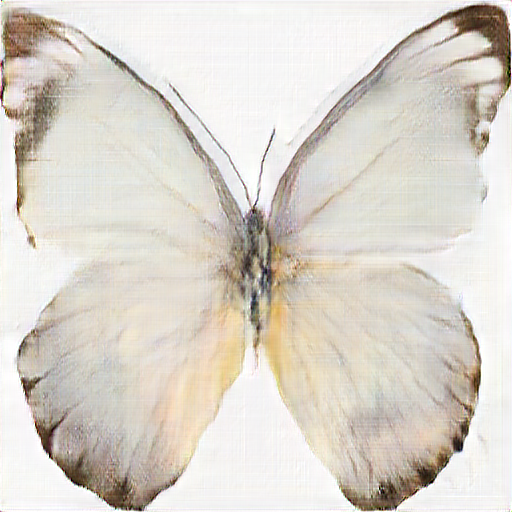

In [18]:
generate_image(bendedgen)

## Trainable bending module

In [ ]:
from bending_modules import BendingConvModule

In [5]:
numchans = [1024, 1024, 512, 256, 128, 64, 6]

bending_idx = 5

bendingmod = BendingConvModule(numchans[bending_idx])

In [6]:
device = 'cuda'

bend_generator = BendedGenerator.from_pretrained("ceyda/butterfly_cropped_uniq1K_512",
                                                 bending_module=bendingmod,
                                                 bending_idx=bending_idx,
                                                 train_bending=True)
bend_generator = bend_generator.to(device)

In [128]:
bend_generator = bend_generator.to('cpu')
out, bend_in, bend_out = bend_generator(torch.randn(16, bend_generator.latent_dim),
                    bend=True, return_inout=True)

In [129]:
bend_in.shape

torch.Size([16, 64, 256, 256])

In [130]:
bend_out.shape

torch.Size([16, 64, 256, 256])

In [133]:
compute_diversity_loss(bend_out, bend_in)

tensor(4.4724, grad_fn=<MeanBackward0>)

In [98]:
torch.cuda.empty_cache()

batch_size = 16
tgt_img = torch.tensor(np.array(Image.open('beach.jpeg'))).permute(2,0,1).float()/255.
tgt_img = T.Resize(size=(512, 512))(tgt_img)
tgt_img = tgt_img.flatten()
tgt_img = tgt_img.unsqueeze(0).repeat(batch_size, 1).to(device)
n_iter = 1000

opt = Adam(bendingmod.parameters(), 1e-3)

loss_log = []

for i in tqdm(range(n_iter)):
    
    out = bend_generator(torch.randn(batch_size, bend_generator.latent_dim, device=device))
    out = out.clamp_(0., 1.).reshape(batch_size, -1)
        

    loss = F.mse_loss(out, tgt_img)
    loss_log.append(loss.detach().cpu().numpy())

    with torch.no_grad():
        loss.backward()
        opt.step()
        opt.zero_grad()
    
    
plt.plot(range(n_iter), loss_log)   

 29%|██▉       | 291/1000 [01:52<04:33,  2.60it/s]


KeyboardInterrupt: 

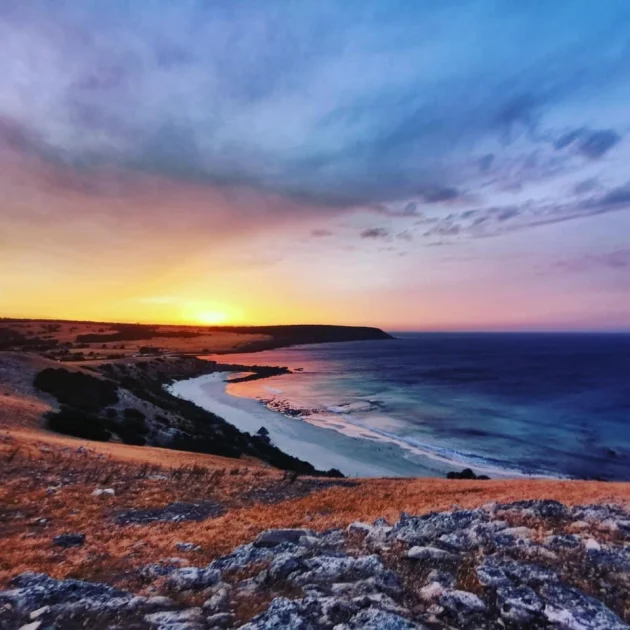

In [68]:
Image.open('beach.jpeg')

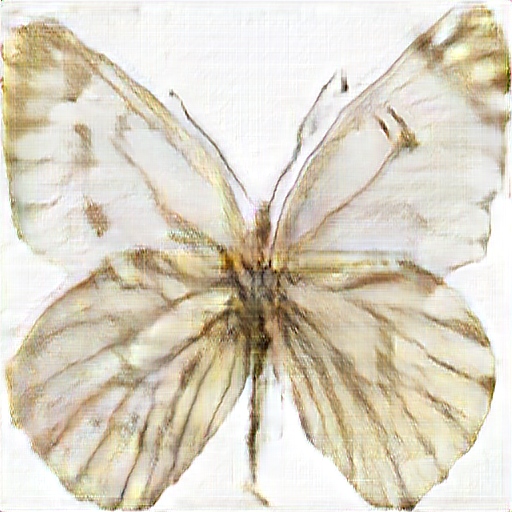

In [74]:
generate_image(bend_generator, bend=False)

In [16]:
def image_grid(imgs, rows, cols):
    assert len(imgs) == rows*cols

    w, h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    grid_w, grid_h = grid.size
    
    for i, img in enumerate(imgs):
        grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

In [85]:
exampleimgs = [generate_image(bend_generator) for _ in range(16)]

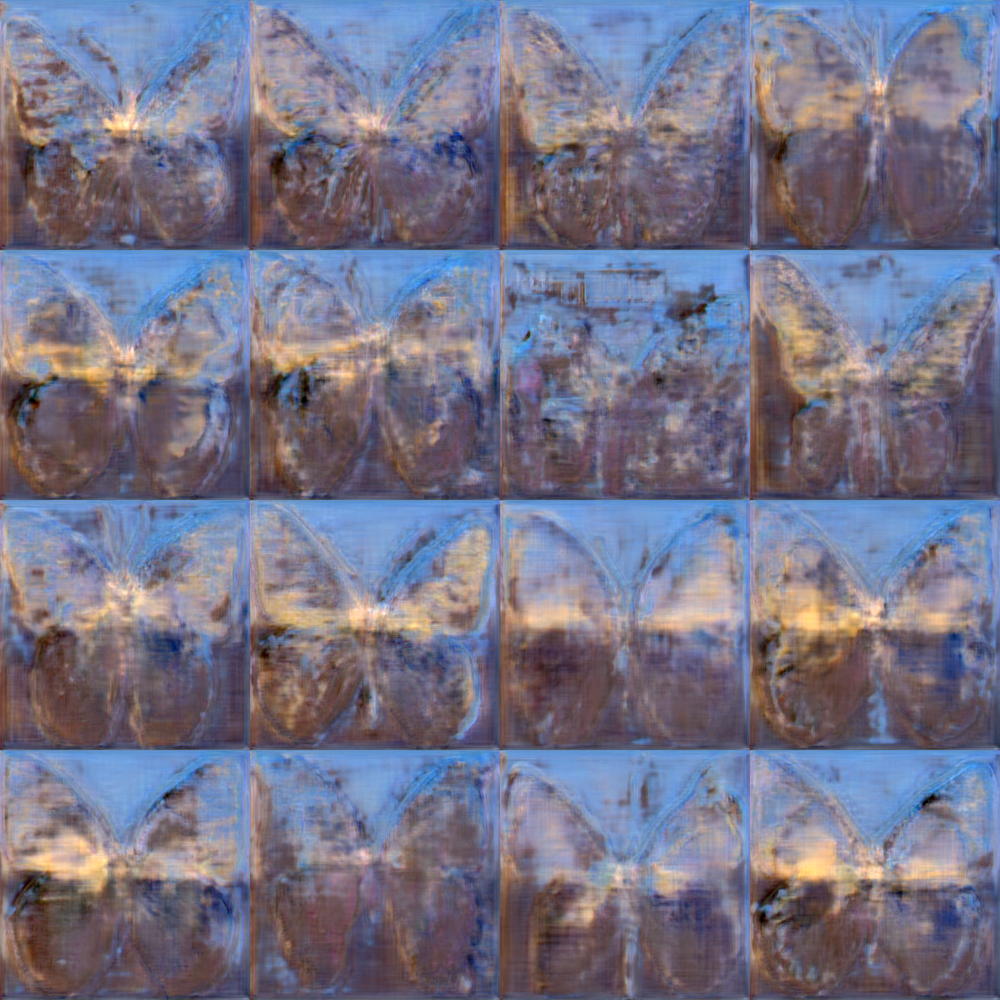

In [86]:
image_grid(exampleimgs, 4, 4)

## CLIP Loss

In [1]:
from clip import TextPrompt

c:\Users\giaco\anaconda3\envs\giatorch\lib\site-packages\tqdm\auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [11]:
# Create new bending module to optimize
# with CLIP loss
bendingmod_clip = BendingConvModule(numchans[bending_idx])

bend_generator_clip = BendedGenerator.from_pretrained("ceyda/butterfly_cropped_uniq1K_512",
                                                 bending_module=bendingmod_clip,
                                                 bending_idx=bending_idx,
                                                 train_bending=True)
bend_generator_clip = bend_generator_clip.to(device)

tgt_text = 'Neon Genesis Evangelion'
text_prompt = TextPrompt(tgt_text)

100%|██████████| 1000/1000 [03:03<00:00,  5.46it/s]


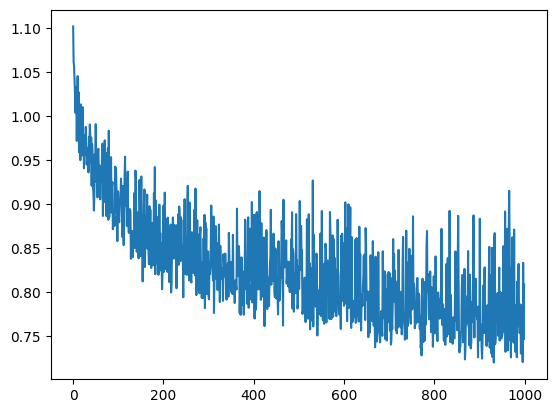

In [94]:
torch.cuda.empty_cache()

batch_size = 16

n_iter = 1000

opt = Adam(bendingmod_clip.parameters(), 1e-4)

loss_log = []

for i in tqdm(range(n_iter)):
    
    noise_input = torch.randn(batch_size, 
                    bend_generator_clip.latent_dim, 
                    device=device)
    
    out = bend_generator_clip(noise_input)
    out = out.clamp_(0., 1.)
        

    loss = text_prompt(out)
    loss_log.append(loss.detach().cpu().numpy())

    with torch.no_grad():
        loss.backward()
        opt.step()
        opt.zero_grad()
    
    
plt.plot(range(n_iter), loss_log)   

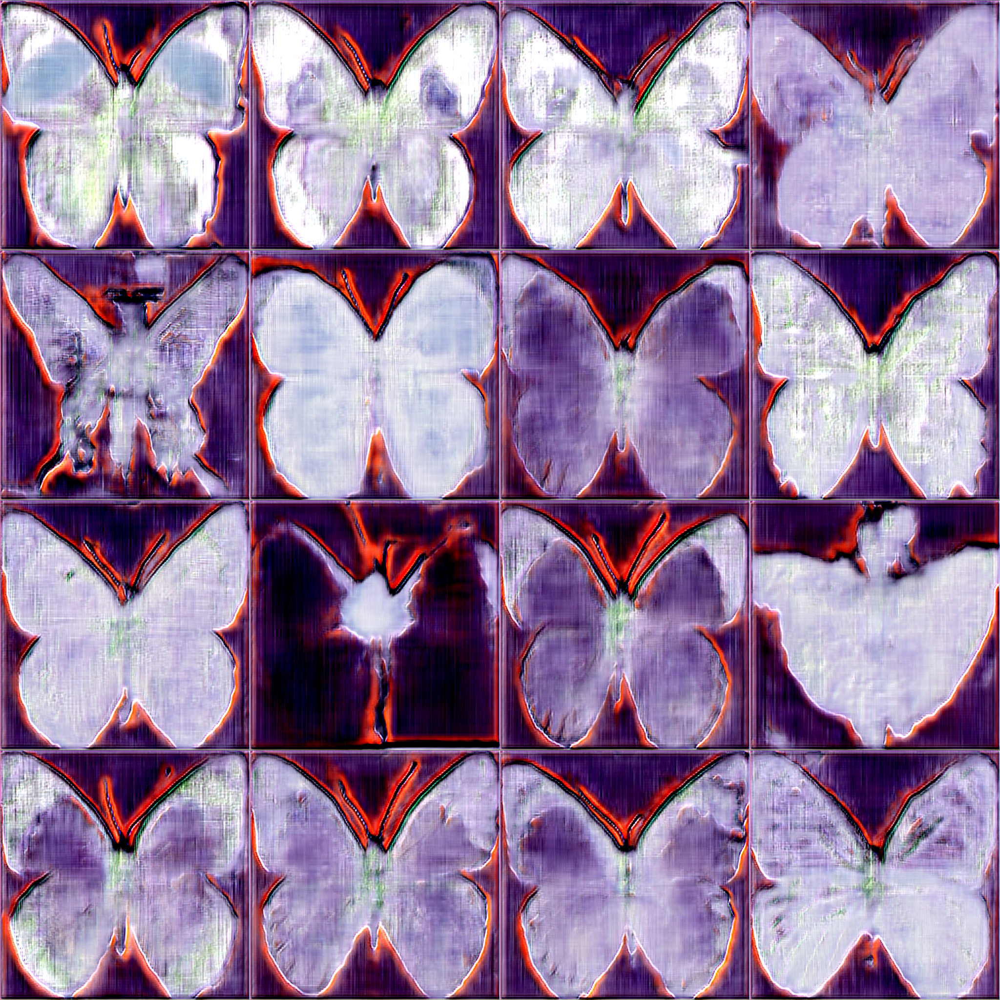

In [96]:
exampleimgs = [generate_image(bend_generator_clip) for _ in range(16)]
image_grid(exampleimgs, 4, 4)

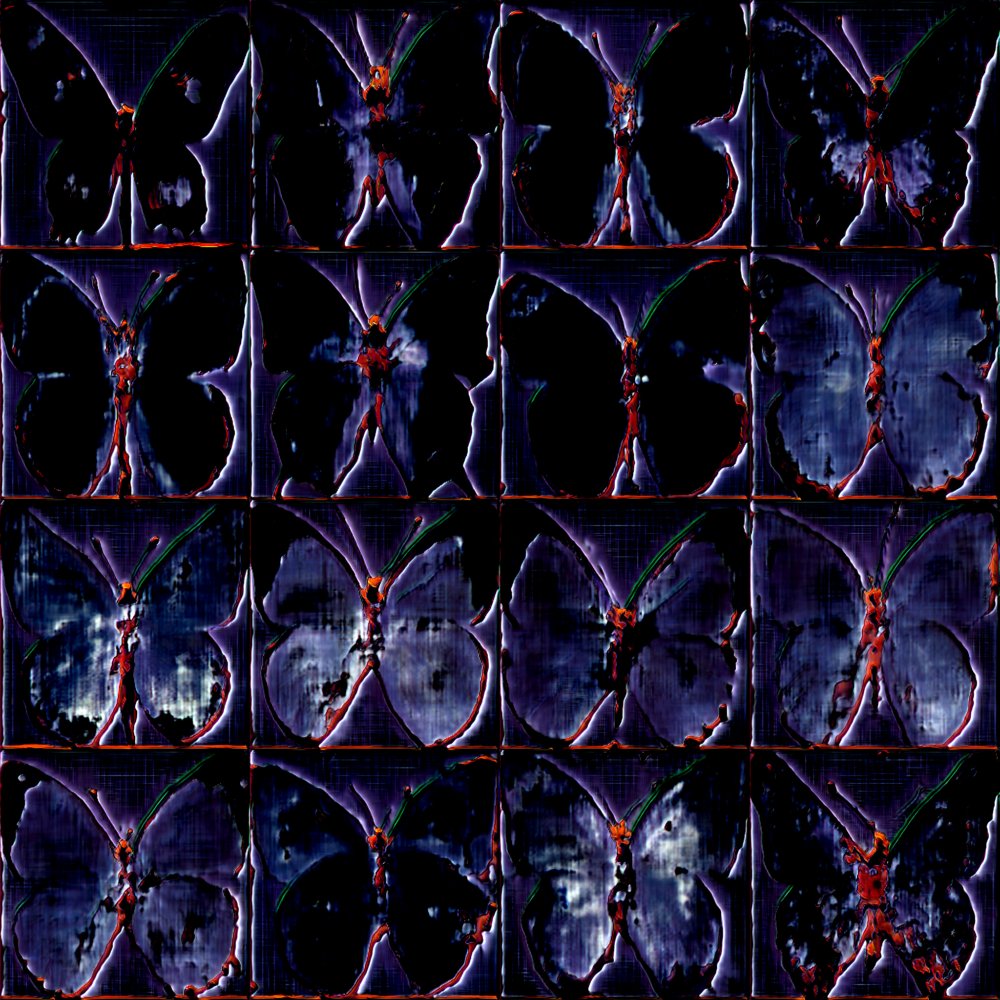

In [89]:
image_grid(exampleimgs, 4, 4)

### Try adding diversity loss

In [12]:
from losses import compute_diversity_loss

In [61]:
# Create new bending module to optimize
# with CLIP loss
bendmod_clip_div = BendingConvModule(numchans[bending_idx])

bend_gen_clip_div = BendedGenerator.from_pretrained("ceyda/butterfly_cropped_uniq1K_512",
                                                 bending_module=bendmod_clip_div,
                                                 bending_idx=bending_idx,
                                                 train_bending=True)
bend_gen_clip_div = bend_gen_clip_div.to(device)

tgt_text = '3D Model of skeleton eating pomegranate, Blender Graphical User Interface, from multiple viewpoints'
text_prompt = TextPrompt(tgt_text)

100%|██████████| 1000/1000 [06:21<00:00,  2.62it/s]


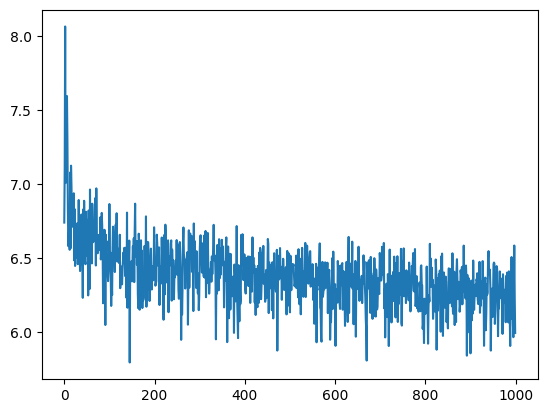

In [62]:
torch.cuda.empty_cache()

batch_size = 32

n_iter = 1000

lz_weight = 6. #3.

opt = Adam(bendmod_clip_div.parameters(), 1e-3)

loss_log = []

for i in tqdm(range(n_iter)):
    
    noise_input = torch.randn(batch_size, 
                    bend_gen_clip_div.latent_dim, 
                    device=device)
    
    out, b_in, b_out = bend_gen_clip_div(noise_input, 
                            return_inout=True)
    out = out.clamp_(0., 1.)
        

    loss = text_prompt(out) + \
        lz_weight * compute_diversity_loss(out, b_in)
    loss_log.append(loss.detach().cpu().numpy())

    with torch.no_grad():
        loss.backward()
        opt.step()
        opt.zero_grad()
    
    
plt.plot(range(n_iter), loss_log)   

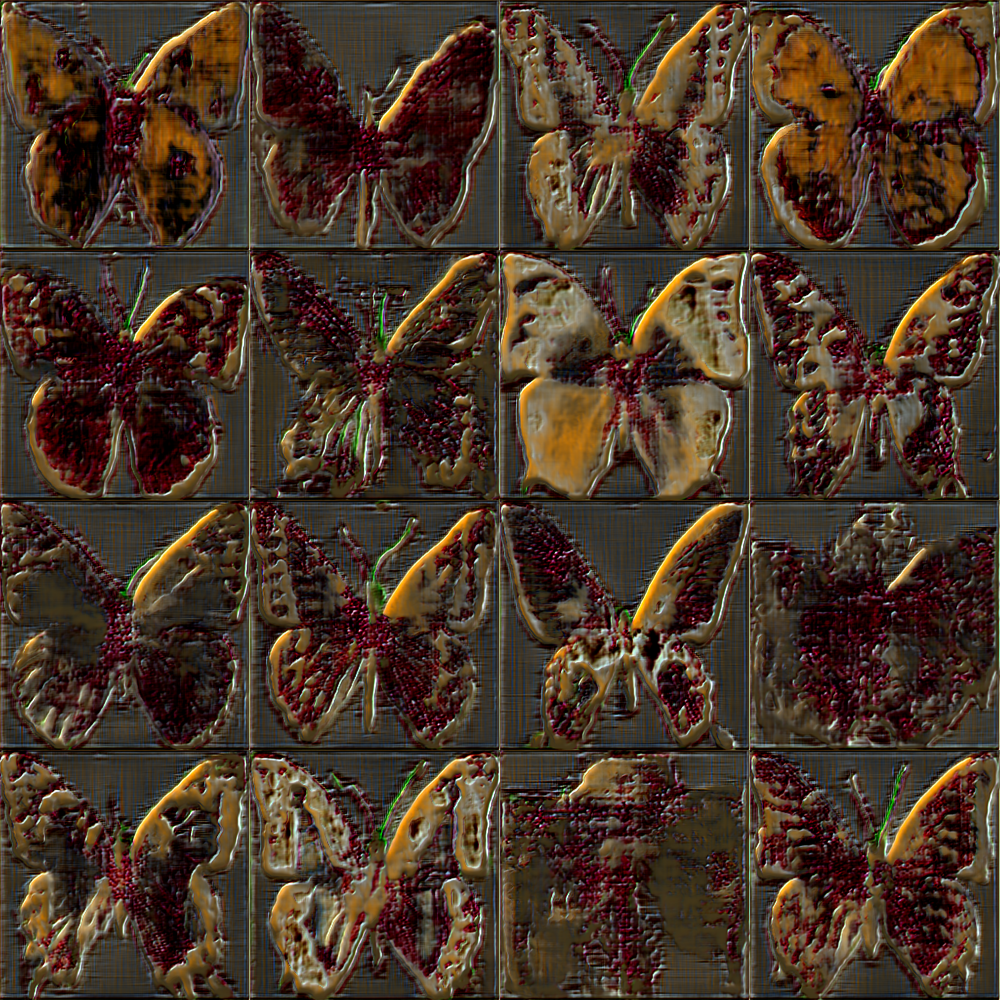

In [65]:
exampleimgs = [generate_image(bend_gen_clip_div) for _ in range(16)]
image_grid(exampleimgs, 4, 4)

### CPPN bending module

In [4]:
from bending_modules import BendingCPPN

In [5]:
cppn = BendingCPPN(256, 64)

In [8]:
x = torch.randn(10, 64, 256, 256)
out = torch.sigmoid(cppn(x))

In [9]:
out.shape

torch.Size([10, 3, 256, 256])

In [10]:
from PIL import Image

In [11]:
img = out[6].permute(1,2,0).detach().numpy() * 255
img = Image.fromarray(img.astype(np.uint8))

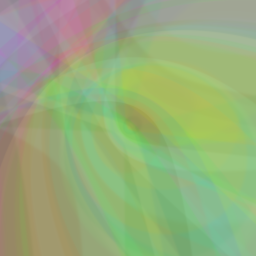

In [13]:
img

In [48]:
aa = torch.randn(8, 8)
bb = aa[None, None, ...]

In [50]:
bb[0][0]

tensor([[-0.1987, -2.1473,  1.1395,  1.6050,  0.9241, -0.8591,  0.8074,  0.7000],
        [-1.0034,  1.1892,  0.6348,  0.8319,  1.1036, -0.1073,  0.6769, -1.6480],
        [-1.3041,  0.9427, -0.6107,  1.0404,  0.3640, -0.7357, -0.3047, -0.9655],
        [ 0.2610,  2.2852, -0.2434,  1.4365, -2.1702, -0.4800,  0.5591,  0.7665],
        [-0.0686, -1.4984, -0.5666, -0.6919,  0.0289, -0.3023, -0.1259,  0.2062],
        [ 0.8979, -2.6164,  0.0572,  0.9009, -0.0150,  0.1383,  0.5409,  0.9354],
        [ 0.3021,  2.0933,  0.8238,  0.3453, -0.2945,  1.1899, -0.5908, -0.2566],
        [-1.8042,  0.4827, -0.5564, -1.0094, -0.6503, -0.4314,  0.2986,  0.2892]])

In [47]:
x.shape

torch.Size([64, 256, 256])